In [3]:
# House Price Prediction using Linear Regression
# A comprehensive analysis implementing regression from scratch

## Overview
# This analysis demonstrates linear regression implementation for predicting house sale prices
# Key components:
# - Data exploration and visualization
# - Custom linear regression implementation
# - Single and multiple feature analysis
# - Model performance evaluation
# - Interactive visualizations

In [4]:
# Essential library imports
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
from pylab import rcParams
import unittest

In [5]:
# Configure visualization settings
%matplotlib inline
sns.set(style='whitegrid', palette='muted', font_scale=1.5)
rcParams['figure.figsize'] = 14, 8

In [6]:
# Set random state for reproducibility
SEED_VALUE = 42
np.random.seed(SEED_VALUE)

In [7]:

def execute_unit_tests():
    """Execute unit tests without exiting notebook"""
    unittest.main(argv=[''], verbosity=1, exit=False)

In [8]:
# Load training and testing datasets
housing_test_data = pd.read_csv("D:\\Downloads\\Linear Regression\\test.csv")
housing_train_data = pd.read_csv(r"D:\Downloads\Linear Regression\train.csv")

In [9]:
# Display initial data structure
housing_test_data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


In [10]:
# Generate descriptive statistics
housing_train_data.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


C:\Users\party\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


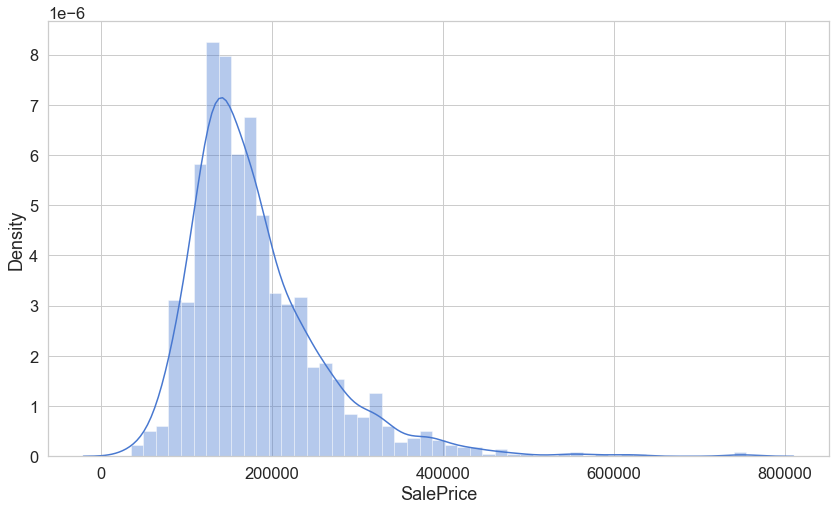

In [11]:
## Exploratory Data Analysis

# Visualize target variable distribution
sns.distplot(housing_train_data['SalePrice'], kde=True)
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='GrLivArea', ylabel='SalePrice'>

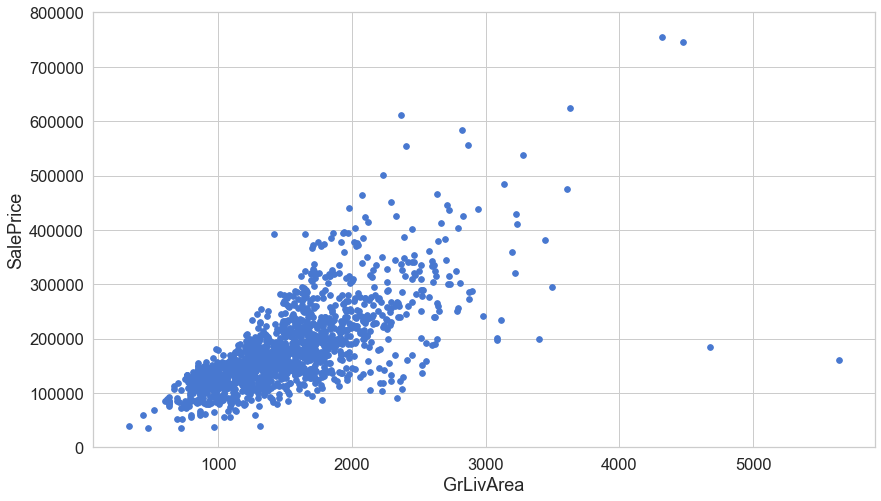

In [12]:
# Analyze relationship between living area and sale price
living_area_feature = 'GrLivArea'
combined_data = pd.concat([housing_train_data['SalePrice'], housing_train_data[living_area_feature]], axis=1)
combined_data.plot.scatter(x=living_area_feature, y='SalePrice', ylim=(0,800000), s=32)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='TotalBsmtSF', ylabel='SalePrice'>

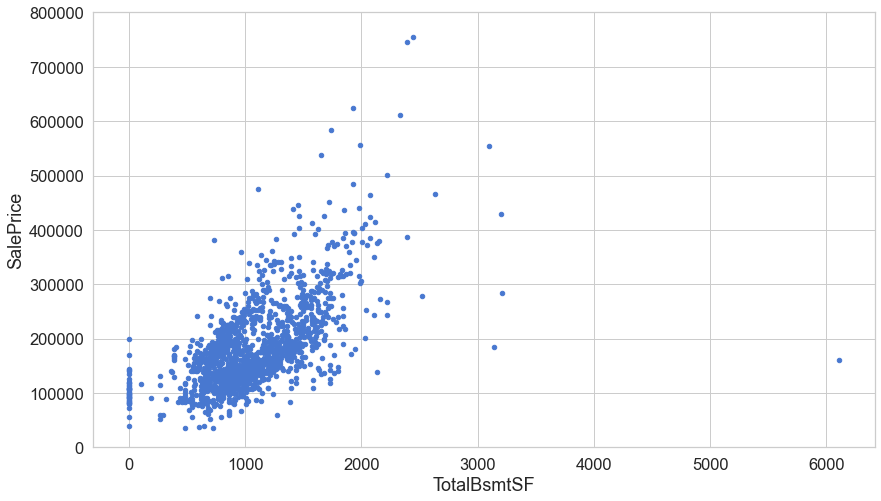

In [13]:
# Examine basement area correlation
basement_feature = 'TotalBsmtSF'
basement_data = pd.concat([housing_train_data['SalePrice'], housing_train_data[basement_feature]], axis=1)
basement_data.plot.scatter(x=basement_feature, y='SalePrice', ylim=(0,800000))

(-0.5, 9.5, 0.0, 800000.0)

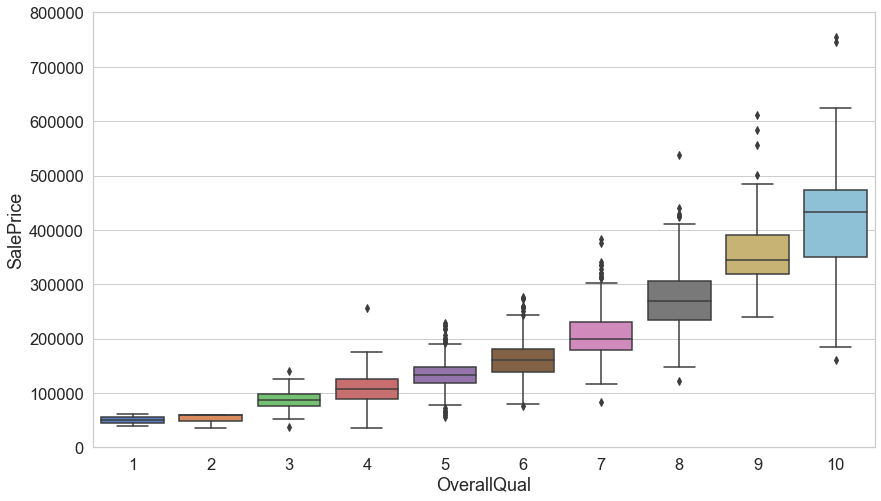

In [14]:
# Quality rating analysis using box plots
quality_feature = 'OverallQual'
quality_data = pd.concat([housing_train_data['SalePrice'], housing_train_data[quality_feature]], axis=1)
plt.figure(figsize=(14, 8))
quality_plot = sns.boxplot(x=quality_feature, y="SalePrice", data=quality_data)
quality_plot.axis(ymin=0, ymax=800000)

<AxesSubplot:>

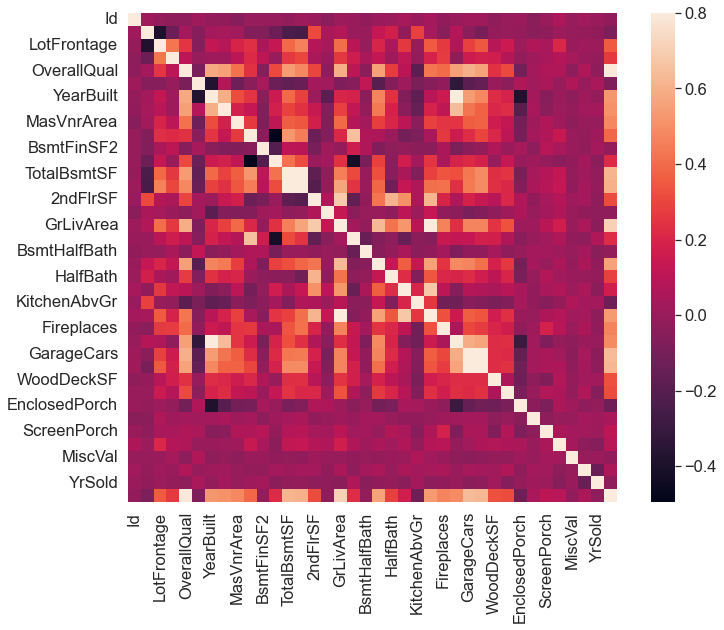

In [15]:
## Correlation Analysis

# Generate full correlation matrix
correlation_matrix = housing_train_data.corr()
plt.figure(figsize=(12, 9))
sns.heatmap(correlation_matrix, vmax=.8, square=True)

<AxesSubplot:>

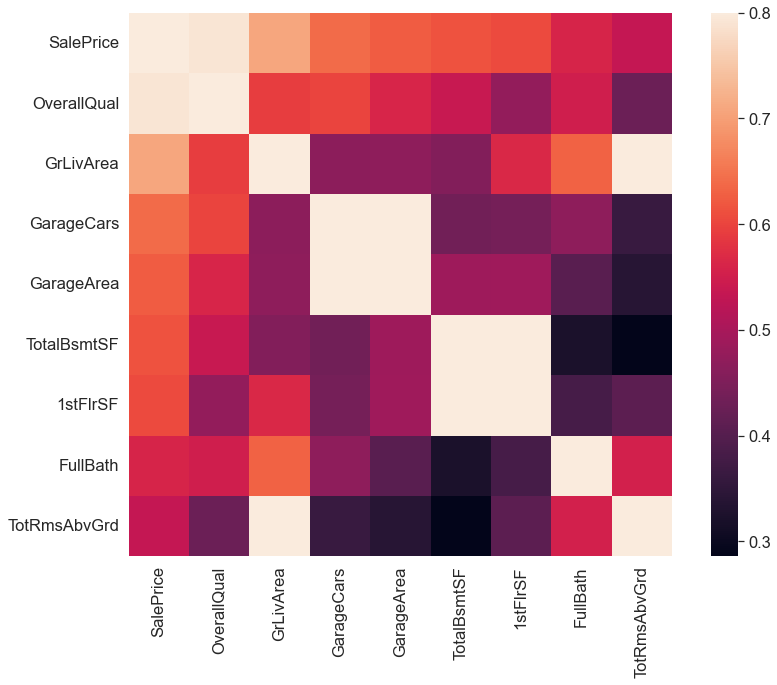

In [16]:
# Focus on top correlations with sale price
top_features_count = 9
top_correlated_features = correlation_matrix.nlargest(top_features_count, 'SalePrice')['SalePrice'].index
plt.figure(figsize=(14, 10))
sns.heatmap(housing_train_data[top_correlated_features].corr(), vmax=.8, square=True)

C:\Users\party\anaconda3\lib\site-packages\seaborn\axisgrid.py:2076: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


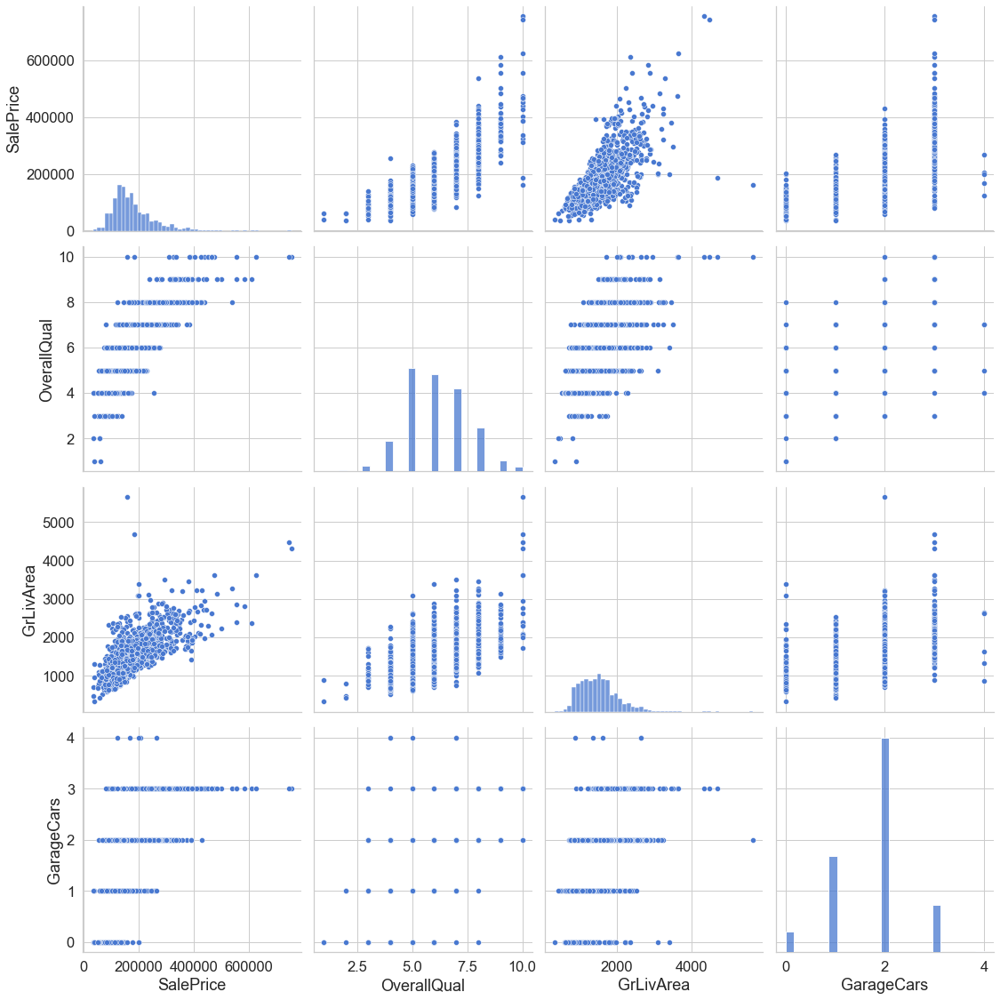

In [17]:
# Pairplot for key features
selected_features = ['SalePrice', 'OverallQual', 'GrLivArea', 'GarageCars']
sns.pairplot(housing_train_data[selected_features], size=4)

In [18]:
## Missing Data Analysis

# Calculate missing values
missing_counts = housing_train_data.isnull().sum().sort_values(ascending=False)
missing_percentages = (housing_train_data.isnull().sum()/housing_train_data.isnull().count()).sort_values(ascending=False)
missing_summary = pd.concat([missing_counts, missing_percentages], axis=1, keys=['Total', 'Percent'])
missing_summary.head(20)

,Total,Percent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageYrBlt,81,0.055479
GarageCond,81,0.055479
GarageType,81,0.055479
GarageFinish,81,0.055479


In [19]:
## Model Implementation

### Data Preprocessing

# Feature standardization using Z-score normalization
# Formula: z = (x - μ) / σ
# where μ is mean and σ is standard deviation


In [20]:
feature_x = housing_train_data['GrLivArea']
target_y = housing_train_data['SalePrice']

In [21]:
# Standardize features
standardized_x = (feature_x - feature_x.mean()) / feature_x.std()
# Add bias term (intercept column)
design_matrix = np.c_[np.ones(standardized_x.shape[0]), standardized_x]

print(f"Design matrix shape: {design_matrix.shape}")

Design matrix shape: (1460, 2)


In [22]:
### Cost Function Implementation

def calculate_cost(predictions, actual_values):
    """
    Calculate Mean Squared Error cost function
    Args:
        predictions: Model predictions
        actual_values: True target values
    Returns:
        Mean squared error
    """
    squared_errors = (predictions - actual_values) ** 2
    sample_count = len(actual_values)
    return 1.0 / (2 * sample_count) * squared_errors.sum()

In [23]:
# Unit tests for cost function
class CostFunctionTests(unittest.TestCase):
    def test_zero_prediction_zero_target(self):
        self.assertAlmostEqual(calculate_cost(h=np.array([0]), y=np.array([0])), 0)
    
    def test_one_prediction_zero_target(self):
        self.assertAlmostEqual(calculate_cost(h=np.array([1]), y=np.array([0])), 0.5)
    
    def test_two_prediction_zero_target(self):
        self.assertAlmostEqual(calculate_cost(h=np.array([2]), y=np.array([0])), 2)
    
    def test_zero_prediction_one_target(self):
        self.assertAlmostEqual(calculate_cost(h=np.array([0]), y=np.array([1])), 0.5)
    
    def test_zero_prediction_two_target(self):
        self.assertAlmostEqual(calculate_cost(h=np.array([0]), y=np.array([2])), 2)

execute_unit_tests()

EEEEE.
ERROR: test_one_prediction_zero_target (__main__.CostFunctionTests)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "C:\Users\party\AppData\Local\Temp/ipykernel_7300/3117619358.py", line 7, in test_one_prediction_zero_target
    self.assertAlmostEqual(calculate_cost(h=np.array([1]), y=np.array([0])), 0.5)
TypeError: calculate_cost() got an unexpected keyword argument 'h'

ERROR: test_two_prediction_zero_target (__main__.CostFunctionTests)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "C:\Users\party\AppData\Local\Temp/ipykernel_7300/3117619358.py", line 10, in test_two_prediction_zero_target
    self.assertAlmostEqual(calculate_cost(h=np.array([2]), y=np.array([0])), 2)
TypeError: calculate_cost() got an unexpected keyword argument 'h'

ERROR: test_zero_prediction_one_target (__main__.CostFunctionTests)
----------------------------------------------

In [24]:
### Custom Linear Regression Implementation

class CustomLinearRegression:
    """
    Linear Regression implementation using gradient descent optimization
    """
    
    def make_prediction(self, feature_matrix):
        """Generate predictions using current weights"""
        return np.dot(feature_matrix, self.weights)
    
    def update_weights(self, feature_matrix, target_values, learning_rate):
        """Perform one gradient descent step"""
        current_predictions = self.make_prediction(feature_matrix)
        prediction_error = current_predictions - target_values
        weight_gradient = np.dot(feature_matrix.T, prediction_error) / len(feature_matrix)
        self.weights -= learning_rate * weight_gradient
    
    def train_model(self, feature_matrix, target_values, iterations=100000, learning_rate=0.01):
        """
        Train the model using gradient descent
        Args:
            feature_matrix: Input features with bias column
            target_values: Target values to predict
            iterations: Number of training iterations
            learning_rate: Step size for gradient descent
        """
        # Initialize weights to zero
        self.weights = np.zeros(feature_matrix.shape[1])
        self.cost_tracking = []
        self.weight_history = [self.weights.copy()]
        
        # Training loop
        for iteration in range(iterations):
            current_prediction = self.make_prediction(feature_matrix)
            current_cost = calculate_cost(current_prediction, target_values)
            self.cost_tracking.append(current_cost)
            
            self.update_weights(feature_matrix, target_values, learning_rate)
            self.weight_history.append(self.weights.copy())
        
        return self

In [25]:
# Unit tests for regression model
class RegressionModelTests(unittest.TestCase):
    def test_weight_convergence(self):
        model = CustomLinearRegression()
        model.train_model(design_matrix, target_y, iterations=2000, learning_rate=0.01)
        expected_weights = np.array([180921.19555322, 56294.90199925])
        np.testing.assert_array_almost_equal(model.weights, expected_weights)

execute_unit_tests()

EEEEE.
ERROR: test_one_prediction_zero_target (__main__.CostFunctionTests)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "C:\Users\party\AppData\Local\Temp/ipykernel_7300/3117619358.py", line 7, in test_one_prediction_zero_target
    self.assertAlmostEqual(calculate_cost(h=np.array([1]), y=np.array([0])), 0.5)
TypeError: calculate_cost() got an unexpected keyword argument 'h'

ERROR: test_two_prediction_zero_target (__main__.CostFunctionTests)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "C:\Users\party\AppData\Local\Temp/ipykernel_7300/3117619358.py", line 10, in test_two_prediction_zero_target
    self.assertAlmostEqual(calculate_cost(h=np.array([2]), y=np.array([0])), 2)
TypeError: calculate_cost() got an unexpected keyword argument 'h'

ERROR: test_zero_prediction_one_target (__main__.CostFunctionTests)
----------------------------------------------

In [26]:
## Model Training and Evaluation

# Initialize and train the regression model
regression_model = CustomLinearRegression()
regression_model.train_model(design_matrix, target_y, iterations=2000, learning_rate=0.01)

print(f"Final model weights: {regression_model.weights}")

Final model weights: [180921.19555322  56294.90199925]


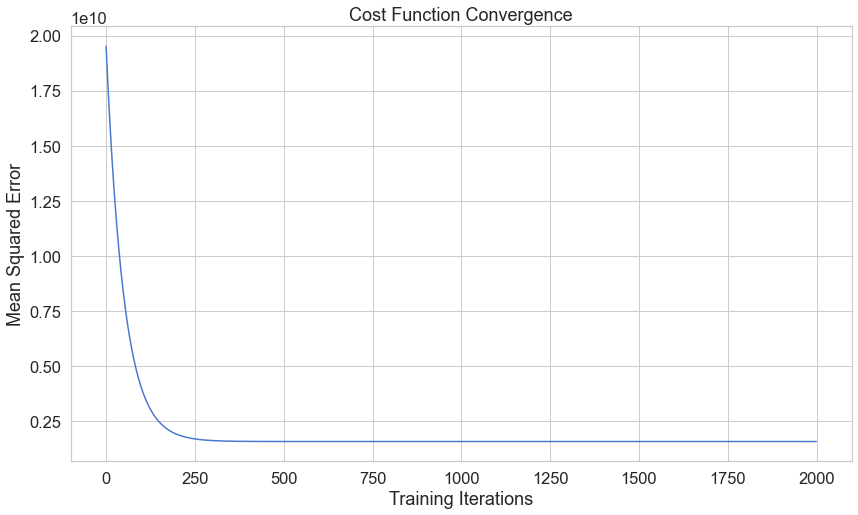

Final cost: 1569921604.8332634


In [27]:
# Visualize cost function convergence
plt.title('Cost Function Convergence')
plt.xlabel('Training Iterations')
plt.ylabel('Mean Squared Error')
plt.plot(regression_model.cost_tracking)
plt.show()

print(f"Final cost: {regression_model.cost_tracking[-1]}")


In [28]:
## Animation Visualization

# Setup animation plot
animation_fig = plt.figure()
animation_axes = plt.axes()
plt.title('House Price vs Living Area (Normalized)')
plt.xlabel('Living Area (Standardized)')
plt.ylabel('Sale Price ($)')
plt.scatter(design_matrix[:,1], target_y)

regression_line, = animation_axes.plot([], [], lw=2, color='red')
cost_annotation = animation_axes.text(-1, 700000, '')
cost_annotation.set_animated(True)
plt.close()

def initialize_animation():
    """Initialize animation elements"""
    regression_line.set_data([], [])
    cost_annotation.set_text('')
    return regression_line, cost_annotation

def create_frame(frame_index):
    """Generate each animation frame"""
    x_range = np.linspace(-5, 20, 1000)
    y_values = regression_model.weight_history[frame_index][1] * x_range + regression_model.weight_history[frame_index][0]
    regression_line.set_data(x_range, y_values)
    cost_annotation.set_text('Cost = %.2f e10' % (regression_model.cost_tracking[frame_index]/10000000000))
    return regression_line, cost_annotation

In [29]:
# Create animation
training_animation = animation.FuncAnimation(
    animation_fig, create_frame, init_func=initialize_animation,
    frames=300, interval=10, blit=True
)

rc('animation', html='jshtml')
training_animation

Animation size has reached 21034297 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [31]:
## Multiple Variable Regression

# Prepare multiple features for enhanced model
multi_features = housing_train_data[['OverallQual', 'GrLivArea', 'GarageCars']]
standardized_features = (multi_features - multi_features.mean()) / multi_features.std()
multi_design_matrix = np.c_[np.ones(standardized_features.shape[0]), standardized_features]

In [32]:
# Train multivariate model
multivar_model = CustomLinearRegression()
multivar_model.train_model(multi_design_matrix, target_y, iterations=2000, learning_rate=0.01)

print(f"Multivariate model weights: {multivar_model.weights}")

Multivariate model weights: [180921.19555322  37478.604254    26631.93830568  15921.22581327]


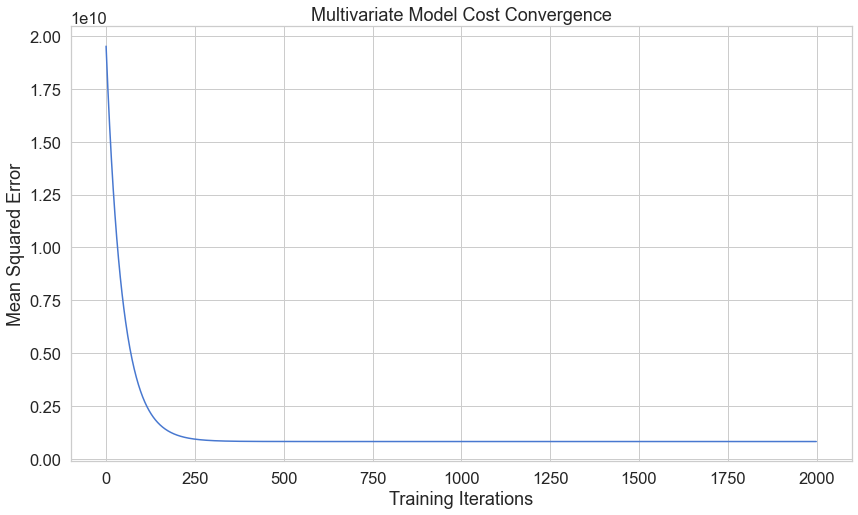

Final multivariate cost: 822817042.8437102


In [33]:
# Visualize multivariate model convergence
plt.title('Multivariate Model Cost Convergence')
plt.xlabel('Training Iterations')
plt.ylabel('Mean Squared Error')
plt.plot(multivar_model.cost_tracking)
plt.show()

print(f"Final multivariate cost: {multivar_model.cost_tracking[-1]}")